In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
# Function to update the lists with new pairs
def update_similarity_lists(similarity, query, target, list_to_update, reverse=False, store_pairs=10):
    list_to_update.append((similarity, query, target))
    list_to_update.sort(key=lambda x: x[0], reverse=reverse)
    if len(list_to_update) > store_pairs:
        list_to_update.pop()

In [3]:
def collecting(directory_path, store_pairs=10, save=False):
    # List to store all similarity scores
    similarity_scores = []

    # Initialize lists to store the top K lowest and highest similarity pairs
    lowest_similarity_pairs = []
    highest_similarity_pairs = []

    # Loop through each file in the directory
    for filename in os.listdir(directory_path):
        if filename.endswith('.csv'):
            file_path = os.path.join(directory_path, filename)
            
            # Read the CSV file
            df = pd.read_csv(file_path, dtype={'Query': str, 'Target': str, 'Similarity': float})
            
            # Assume the similarity scores are in a column named 'similarity'
            similarity_scores.extend(df['Similarity'].tolist())

            # Iterate through each row in the DataFrame
            for index, row in df.iterrows():
                similarity = row['Similarity']
                query_image_name = row['Query']
                target_image_name = row['Target']
                
                # Update the lowest and highest similarity lists
                update_similarity_lists(similarity, query_image_name, target_image_name, lowest_similarity_pairs, store_pairs=store_pairs)
                update_similarity_lists(similarity, query_image_name, target_image_name, highest_similarity_pairs, reverse=True, store_pairs=store_pairs)


    # Convert the lists to DataFrames
    lowest_df = pd.DataFrame(lowest_similarity_pairs, columns=['Similarity', 'Query', 'Target'])
    highest_df = pd.DataFrame(highest_similarity_pairs, columns=['Similarity', 'Query', 'Target'])

    # Ensure 'Query Image Name' and 'Target Image Name' are treated as strings
    lowest_df['Query'] = lowest_df['Query'].astype(str)
    lowest_df['Target'] = lowest_df['Target'].astype(str)
    highest_df['Query'] = highest_df['Query'].astype(str)
    highest_df['Target'] = highest_df['Target'].astype(str)

    # Save to CSV files
    if save:
        # Define paths for the output CSV files
        lowest_similarity_csv = directory_path + 'min_max_pairs/' + 'lowest_similarity_pairs.csv'
        highest_similarity_csv = directory_path + 'min_max_pairs/' + 'highest_similarity_pairs.csv'

        lowest_df.to_csv(lowest_similarity_csv, index=False)
        highest_df.to_csv(highest_similarity_csv, index=False)

        print(f"Saved lowest similarity pairs to {lowest_similarity_csv}")
        print(f"Saved highest similarity pairs to {highest_similarity_csv}")

    return similarity_scores, lowest_similarity_pairs, highest_similarity_pairs

    

In [4]:
def plotting(similarity_scores, bins=50, title=""):
    weights = [1 / len(similarity_scores)] * len(similarity_scores)

    # Plot the distribution of similarity scores
    plt.figure(figsize=(10, 6))
    plt.hist(similarity_scores, bins=bins, alpha=0.7, weights=weights)
    plt.title(title + " Distribution of Similarity")
    plt.xlabel('Similarity Score')
    plt.ylabel('Frequency')
    plt.xlim(-1, 1)
    plt.grid(axis='y', alpha=0.75)
    plt.show()

In [18]:
def compare_plotting(similarity_scores1, similarity_scores2, bins=50, title="", label=['', '']):
    weights1 = [1 / len(similarity_scores1)] * len(similarity_scores1)
    weights2 = [1 / len(similarity_scores2)] * len(similarity_scores2)

    # Plot the distribution of similarity scores
    plt.figure(figsize=(10, 6))
    plt.hist([similarity_scores1, similarity_scores2], bins=bins, alpha=0.7, weights=[weights1, weights2], label=label)
    plt.title(title + " Distribution of Similarity")
    plt.xlabel('Similarity Score')
    plt.ylabel('Frequency')
    plt.xlim(0, 1)
    plt.grid(axis='y', alpha=0.75)
    plt.legend()
    plt.show()

# Eigen Places

In [4]:
# Directory containing the CSV files
EP_neighbors_path = "/users/eleves-a/2022/haiyang.jiang/Trans_Proj/repo/VPR_Proj/result/EigenPlaces/neighbors/"

In [5]:
similarity_EP_neighbors, lowest_pairs_EP_neighbors, highest_pairs_EP_neighbors = collecting(EP_neighbors_path)

In [27]:
print(len(similarity_EP_neighbors))

119140


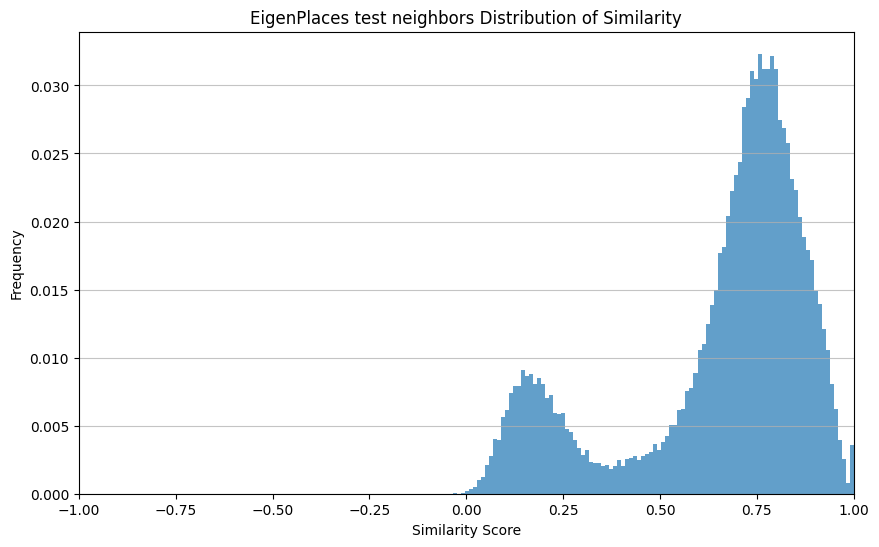

In [14]:
plotting(similarity_EP_neighbors, bins=100, title="EigenPlaces test neighbors")

In [6]:
# Directory containing the CSV files
EP_strangers_path = "/users/eleves-a/2022/haiyang.jiang/Trans_Proj/repo/VPR_Proj/result/EigenPlaces/strangers/"

In [7]:
similarity_EP_strangers, lowest_pairs_EP_strangers, highest_pairs_EP_strangers = collecting(EP_strangers_path)

In [26]:
print(len(similarity_EP_strangers))

216509


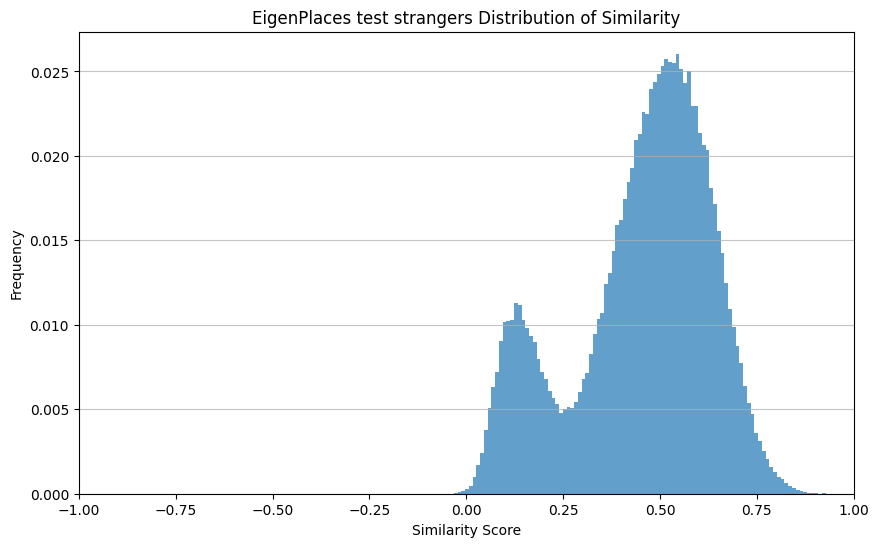

In [17]:
plotting(similarity_EP_strangers, bins=100, title="EigenPlaces test strangers")

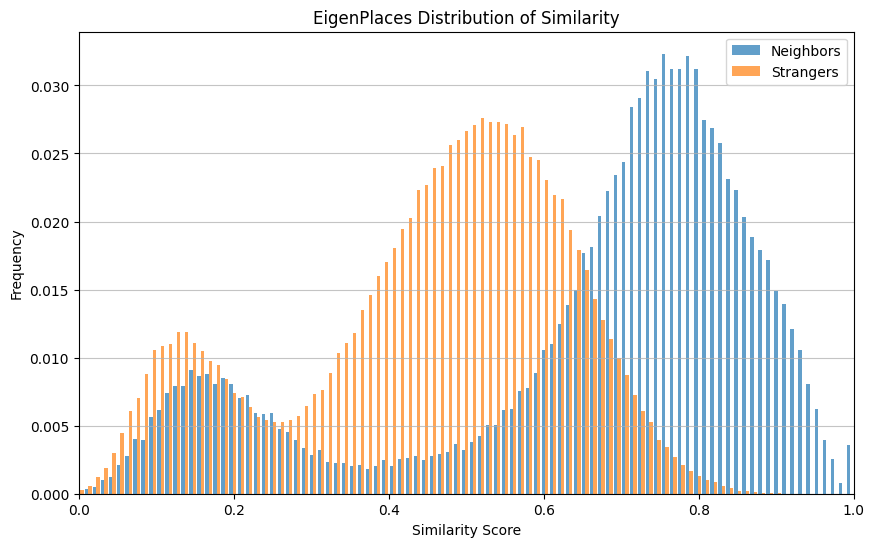

In [19]:
compare_plotting(similarity_EP_neighbors, similarity_EP_strangers, bins=100, title="EigenPlaces", label=['Neighbors', 'Strangers'])

# MixVPR

In [8]:
# Directory containing the CSV files
MVPR_neighbors_path = "/users/eleves-a/2022/haiyang.jiang/Trans_Proj/repo/VPR_Proj/result/MixVPR/neighbors/"

In [9]:
similarity_MVPR_neighbors, lowest_pairs_MVPR_neighbors, highest_pairs_MVPR_neighbors = collecting(MVPR_neighbors_path)

In [24]:
print(len(similarity_MVPR_neighbors))

119144


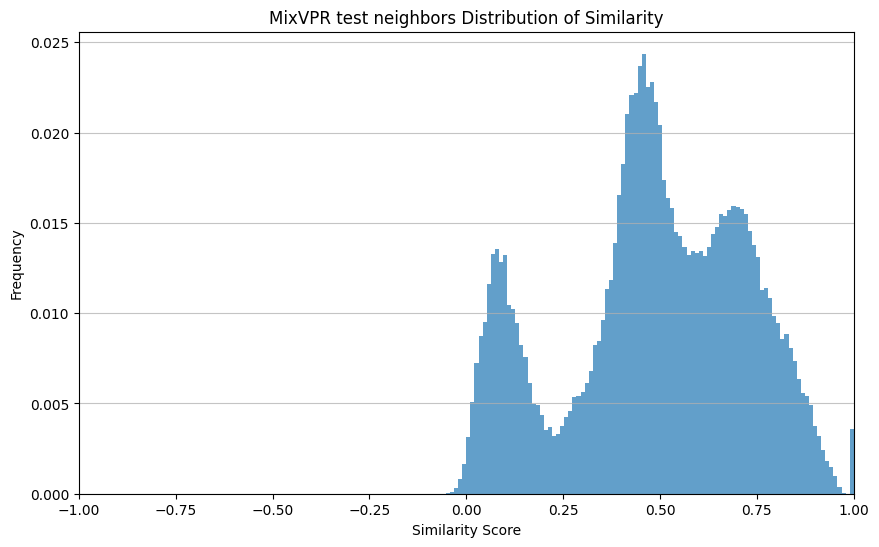

In [7]:
plotting(similarity_MVPR_neighbors, bins=100, title="MixVPR test neighbors")

In [10]:
# Directory containing the CSV files
MVPR_strangers_path = "/users/eleves-a/2022/haiyang.jiang/Trans_Proj/repo/VPR_Proj/result/MixVPR/strangers/"

In [11]:
similarity_MVPR_strangers, lowest_pairs_MVPR_strangers, highest_pairs_MVPR_strangers = collecting(MVPR_strangers_path)

In [25]:
print(len(similarity_MVPR_strangers))

211530


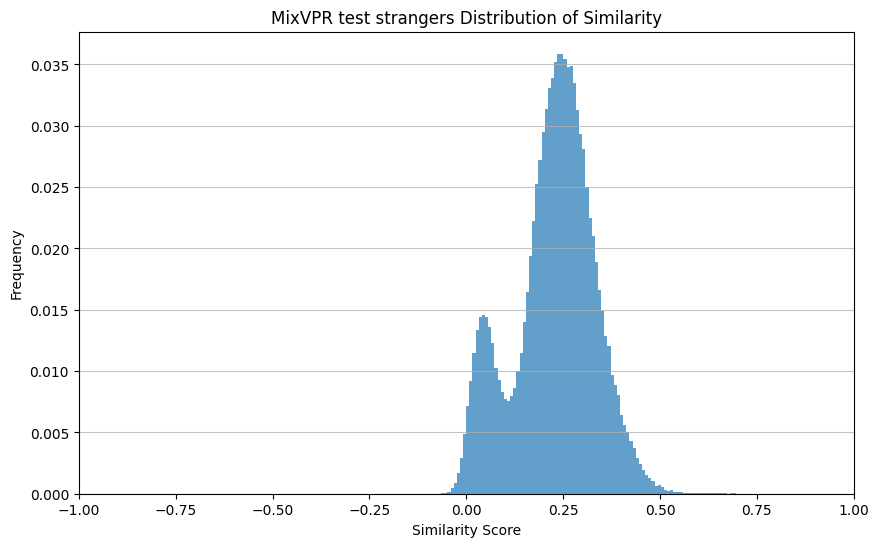

In [10]:
plotting(similarity_MVPR_strangers, bins=100, title="MixVPR test strangers")

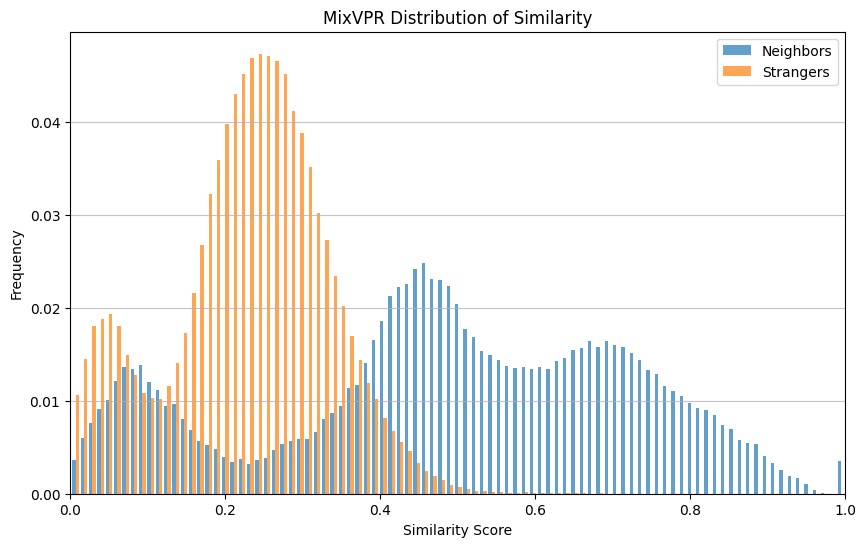

In [20]:
compare_plotting(similarity_MVPR_neighbors, similarity_MVPR_strangers, bins=100, title="MixVPR", label=['Neighbors', 'Strangers'])

# Cross Comparison

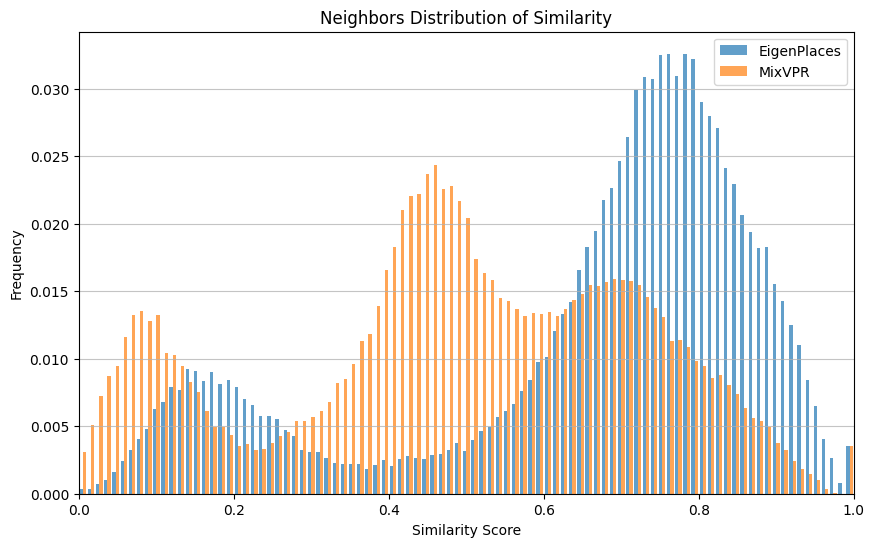

In [21]:
compare_plotting(similarity_EP_neighbors, similarity_MVPR_neighbors, bins=100, title="Neighbors", label=['EigenPlaces', 'MixVPR'])

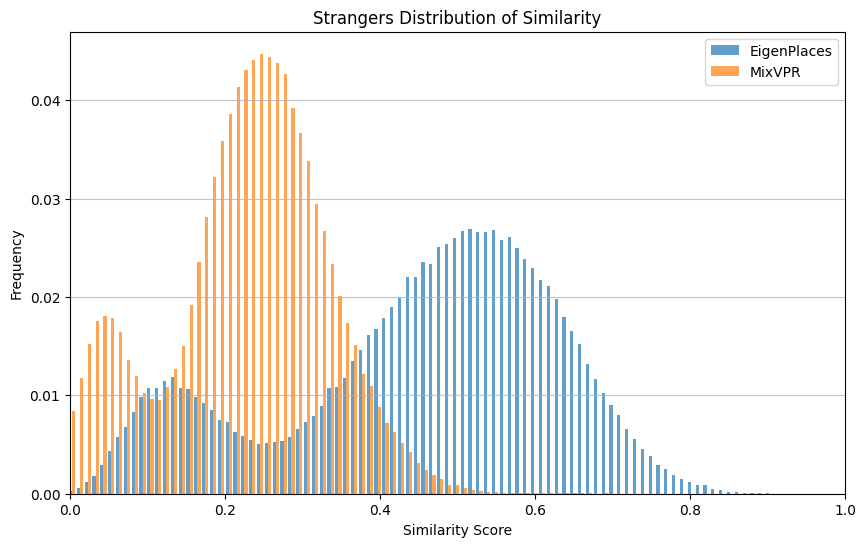

In [22]:
compare_plotting(similarity_EP_strangers, similarity_MVPR_strangers, bins=100, title='Strangers', label=['EigenPlaces', 'MixVPR'])

# Examples

In [12]:
import matplotlib.pyplot as plt
from PIL import Image
import os

In [13]:
data_dir_path = "/Data/Trans_Proj/data/street_view_images_raw/"

In [19]:
def plot_image_pairs(image_pairs, title=''):
    # Set up the figure size and subplots
    fig, axes = plt.subplots(len(image_pairs), 2, figsize=(10, 3 * len(image_pairs)))
    
    # If only one pair, axes dimensions are reduced
    if len(image_pairs) == 1:
        axes = [axes]
    
    for i, (similarity, query_filename, target_filename) in enumerate(image_pairs):
        # Construct the full path to the images
        query_image_path = os.path.join(data_dir_path, query_filename + '.jpg')
        target_image_path = os.path.join(data_dir_path, target_filename + '.jpg')
        
        # Load the images
        query_image = Image.open(query_image_path)
        target_image = Image.open(target_image_path)
        
        # Plot query image
        axes[i][0].imshow(query_image)
        axes[i][0].axis('off')  # Hide axes ticks
        
        # Plot target image
        axes[i][1].imshow(target_image)
        axes[i][1].axis('off')
        
        # Set title with similarity score
        axes[i][0].set_title(f'Query: {query_filename}')
        axes[i][1].set_title(f'Target: {target_filename} with Similarity: {similarity}')
        
    plt.suptitle(title, fontsize=16, fontweight='bold')
    plt.tight_layout(rect=[0, 0, 1, 0.95])  # Adjust the layout to make room for the big title
    plt.show()


## EigenPlaces

### Neigbhor Positive Examples

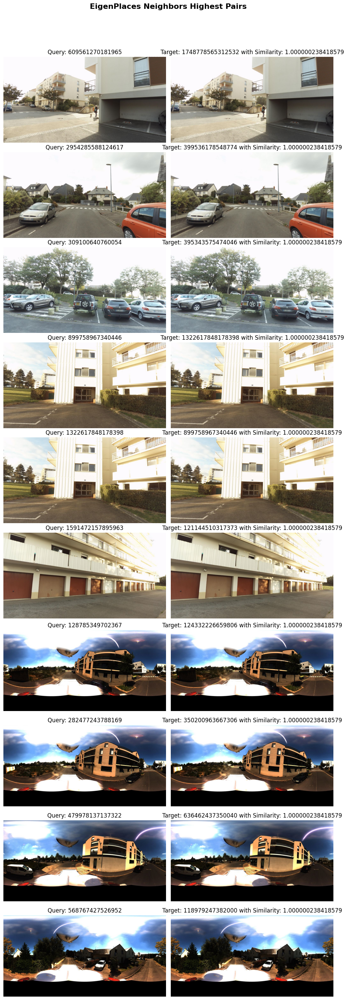

In [20]:
plot_image_pairs(highest_pairs_EP_neighbors, title='EigenPlaces Neighbors Highest Pairs')

### Neigbhor Negative Examples

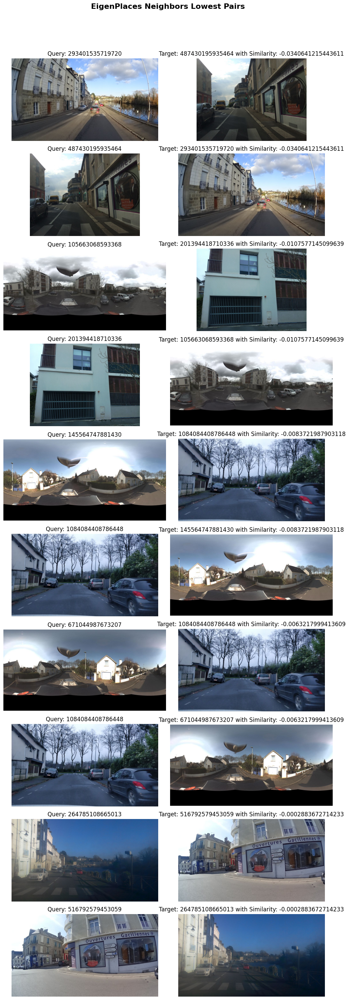

In [22]:
plot_image_pairs(lowest_pairs_EP_neighbors, title='EigenPlaces Neighbors Lowest Pairs')

### Stranger Positive Examples

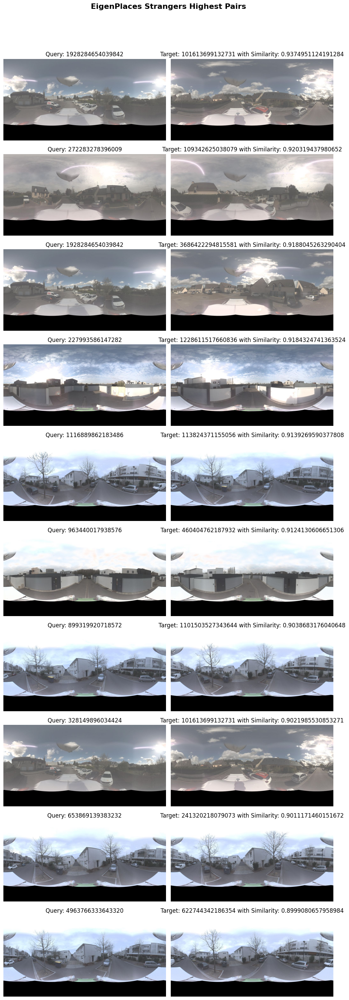

In [25]:
plot_image_pairs(highest_pairs_EP_strangers, title='EigenPlaces Strangers Highest Pairs')

### Stranger Negative Examples

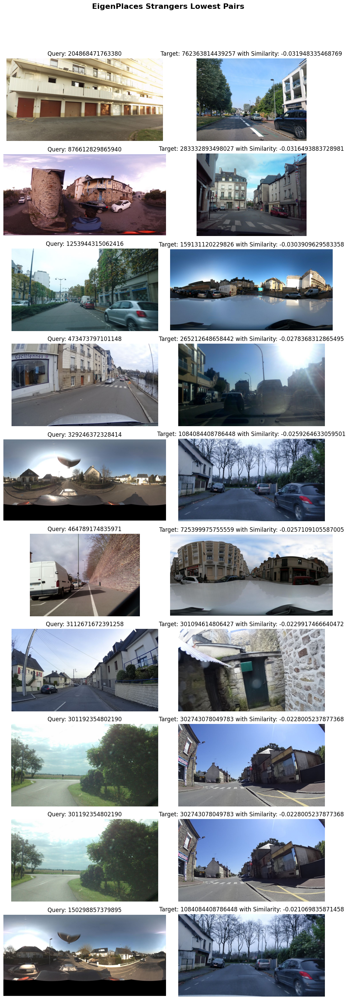

In [26]:
plot_image_pairs(lowest_pairs_EP_strangers, title='EigenPlaces Strangers Lowest Pairs')

## MixVPR

### Neigbhor Positive Examples

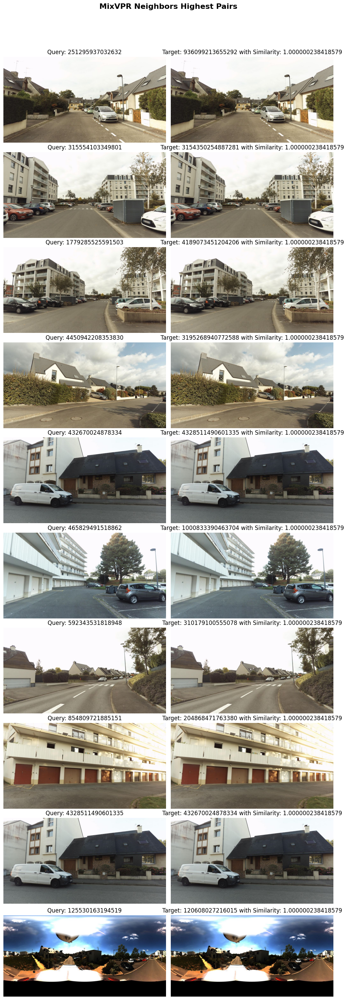

In [23]:
plot_image_pairs(highest_pairs_MVPR_neighbors, title='MixVPR Neighbors Highest Pairs')

### Neigbhor Negative Examples

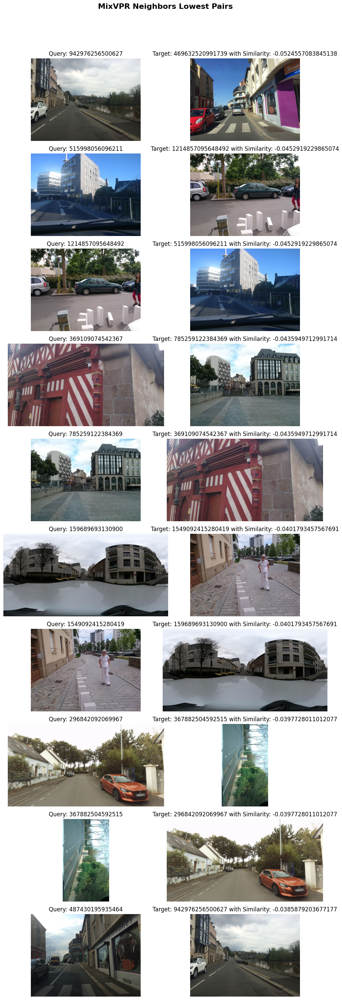

In [29]:
plot_image_pairs(lowest_pairs_MVPR_neighbors, title='MixVPR Neighbors Lowest Pairs')

### Stranger Positive Examples

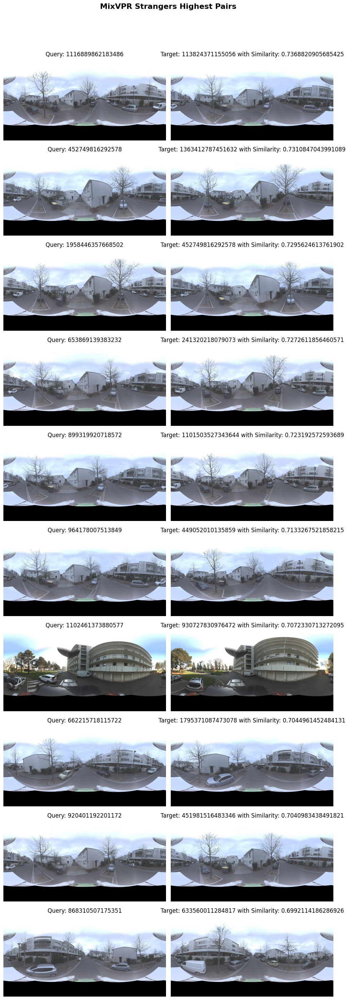

In [27]:
plot_image_pairs(highest_pairs_MVPR_strangers, title='MixVPR Strangers Highest Pairs')

### Stranger Negative Examples

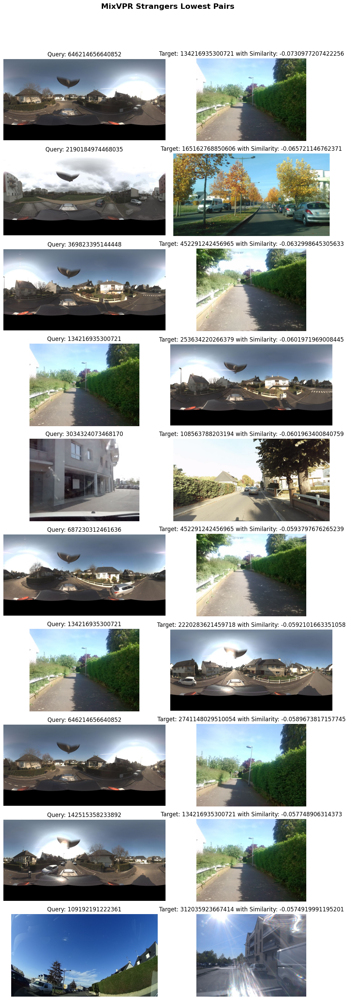

In [28]:
plot_image_pairs(lowest_pairs_MVPR_strangers, title='MixVPR Strangers Lowest Pairs')